Using a very simple cellular automata to track disturbed and undisturbed cells. 

# Initial state

The initial state is a 2D array of 0s and 1s. 0s represent undisturbed cells and 1s represent disturbed cells.

Cells are considered disturbed if they have a tree cover below median - 2 * std where those metrics are computed on the time series and per tree type : deciduous or evergreen. 

100%|██████████| 39/39 [00:00<00:00, 104.75it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


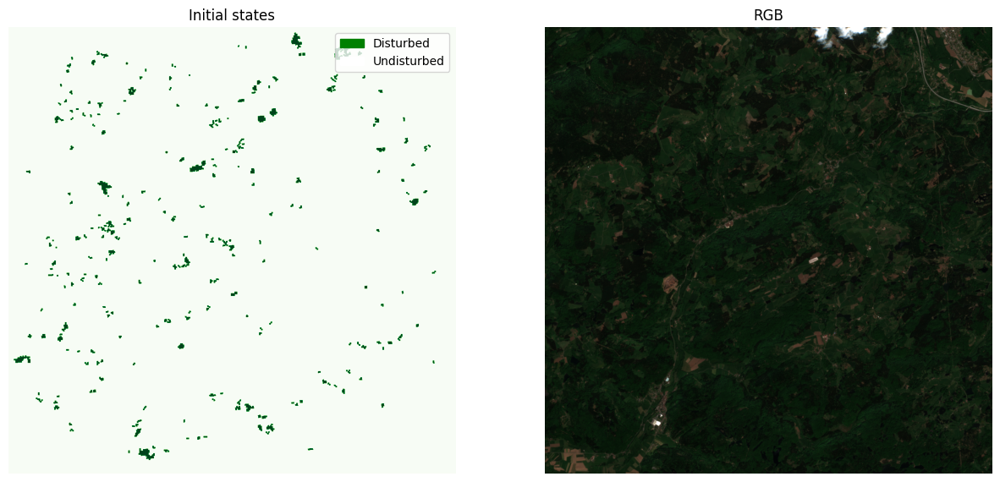

In [136]:
%matplotlib inline

import rasterio
import numpy as np
from utils import load_folder, normalize
from datetime import datetime

def compute_stats(tree_cover, mask, cover_type, disturbance):
    """Compute median and standard deviation of tree cover for a specified cover type."""
    filtered_data = tree_cover[:, (mask == cover_type) & (disturbance == 1)]
    median = np.nanmedian(filtered_data)
    std_dev = np.nanstd(filtered_data)
    min_val = np.nanmin(filtered_data)
    max_val = np.nanmax(filtered_data)
    return median, std_dev, min_val, max_val

def initialize_states(tree_cover, deciduous_evergreen_map):
    """Initialize states based on tree cover and deciduous vs evergreen map."""
    states = np.zeros_like(tree_cover[0], dtype=np.int32)  # 0 = undisturbed, 1 = disturbed
    
    # Compute stats for deciduous (assumed to be O) and evergreen (assumed to be 1)
    deciduous_median, deciduous_std = compute_stats(tree_cover, deciduous_evergreen_map, 0)
    evergreen_median, evergreen_std = compute_stats(tree_cover, deciduous_evergreen_map, 1)
    
    # Set states
    disturbed_threshold_deciduous = deciduous_median - 2 * deciduous_std
    disturbed_threshold_evergreen = evergreen_median - 2 * evergreen_std
    
    # Apply thresholds
    states[(deciduous_evergreen_map == 0) & (tree_cover[0] < disturbed_threshold_deciduous)] = 1
    states[(deciduous_evergreen_map == 1) & (tree_cover[0] < disturbed_threshold_evergreen)] = 1
    
    return states

# Example usage
import os 
folder_path = '/Users/arthurcalvi/Data/disturbances-ex/bbox_sampling/324_20141228_20231228_fr-BourgogneFrancheComte-HauteSaone_Lat47.88_Lon6.60'
tc = load_folder(os.path.join(folder_path, 'smoothed_treecover'))
rgb = load_folder(os.path.join(folder_path, 'rgb'))
disturbances = load_folder(os.path.join(folder_path, 'disturbances'))
sudden_disturbances = np.array([np.isin(disturbance, [1, 4, 5]) for disturbance in disturbances])
gradual_disturbances = np.array([np.isin(disturbance, [2, 3, 6]) for disturbance in disturbances])

gradual_disturbance_map = np.any(gradual_disturbances > 0, axis=0).astype(int)
sudden_disturbance_map = np.any(sudden_disturbances > 0, axis=0).astype(int)

 #TREE TYPE
tree_inf_folder= os.path.join(folder_path, 'tree_class')
#read one file contained
with rasterio.open(os.path.join(tree_inf_folder, os.listdir(tree_inf_folder)[0])) as src:
    tree_inf = src.read(1).astype('float32')

tree_inf[ tree_inf == -1] = np.nan

dates = [datetime.strptime(filename.split('_')[0], '%Y-%m-%d') for filename in os.listdir(os.path.join(folder_path, 'rgb'))]
dates.sort()

# initial_states = initialize_states(tc, tree_inf)
initial_states = (disturbances[0] > 0)

import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

ax[0].imshow(initial_states, cmap='Greens')
ax[0].set_title('Initial states')
ax[0].axis('off')
ax[1].imshow(normalize(rgb[0]).transpose(1, 2, 0))
ax[1].set_title('RGB')
ax[1].axis('off')

#add legend 1 = disturbed, 0 = undisturbed
import matplotlib.patches as mpatches
disturbed_patch = mpatches.Patch(color='green', label='Disturbed')
undisturbed_patch = mpatches.Patch(color='white', label='Undisturbed')
ax[0].legend(handles=[disturbed_patch, undisturbed_patch], loc='upper right')


In [96]:
# Compute stats for deciduous (assumed to be O) and evergreen (assumed to be 1)
gradual_deciduous_median, gradual_deciduous_std, gradual_deciduous_min, gradual_deciduous_max = compute_stats(tc, tree_inf, 0, gradual_disturbance_map)
gradual_evergreen_median, gradual_evergreen_std, gradual_evergreen_min, gradual_evergreen_max = compute_stats(tc, tree_inf, 1, gradual_disturbance_map)
sudden_deciduous_median, sudden_deciduous_std, sudden_deciduous_min, sudden_deciduous_max = compute_stats(tc, tree_inf, 0, sudden_disturbance_map)
sudden_evergreen_median, sudden_evergreen_std, sudden_evergreen_min, sudden_evergreen_max = compute_stats(tc, tree_inf, 1, sudden_disturbance_map)
print(f'Gradual deciduous: median={gradual_deciduous_median}, std={gradual_deciduous_std}, min={gradual_deciduous_min}, max={gradual_deciduous_max}')
print(f'Gradual evergreen: median={gradual_evergreen_median}, std={gradual_evergreen_std}, min={gradual_evergreen_min}, max={gradual_evergreen_max}')
print(f'Sudden deciduous: median={sudden_deciduous_median}, std={sudden_deciduous_std}, min={sudden_deciduous_min}, max={sudden_deciduous_max}')
print(f'Sudden evergreen: median={sudden_evergreen_median}, std={sudden_evergreen_std}, min={sudden_evergreen_min}, max={sudden_evergreen_max}')


Gradual deciduous: median=0.5261632800102234, std=0.2808663547039032, min=0.004671020433306694, max=1.0331039428710938
Gradual evergreen: median=0.7015767097473145, std=0.2503909766674042, min=0.012942400760948658, max=1.023561716079712
Sudden deciduous: median=0.527409553527832, std=0.28803902864456177, min=0.004671020433306694, max=1.0311286449432373
Sudden evergreen: median=0.7137448787689209, std=0.26216989755630493, min=0.007097275462001562, max=1.0400331020355225


# Iteration

Fitted parameters for Deciduous: a=0.23, phi=-1.32, b=0.62


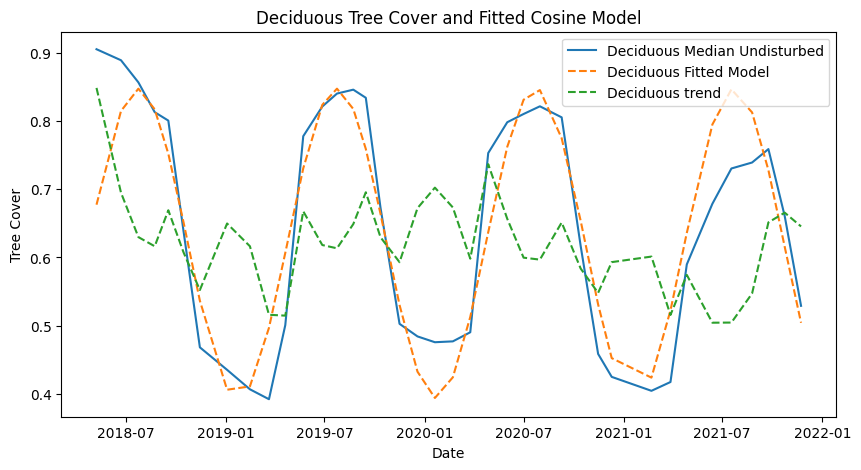

Fitted parameters for Evergreen: a=0.12, phi=-1.15, b=0.76


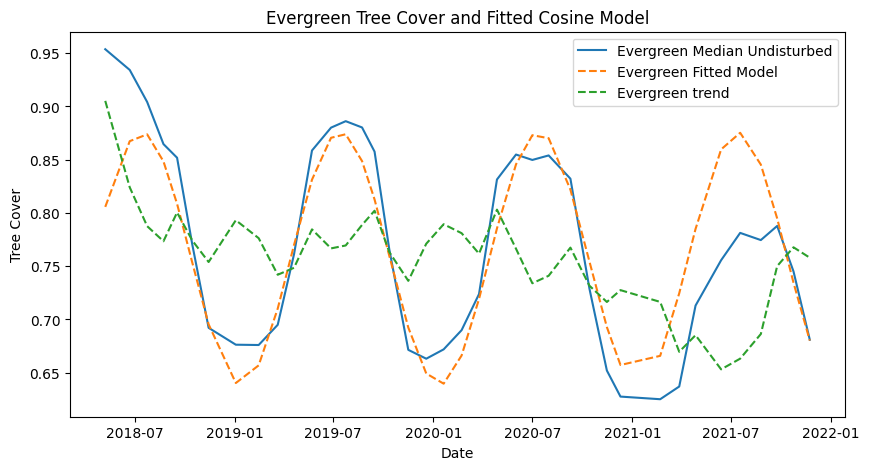

array([ 0.11840266, -1.14881803,  0.        ])

In [203]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from datetime import datetime

# Convert datetime to numerical day of year for fitting
day_of_year = np.array([(date - dates[0]).days for date in dates])

# Define the cosine function to fit
def cosine_function(t, a, phi, b):
    return a * np.cos(2 * np.pi * t / 365.25 + phi) + b

def fit_and_plot(time_series, day_of_year, label, plot=True):
    # Curve fitting
    params, params_covariance = curve_fit(cosine_function, day_of_year, time_series,
                                          p0=[1, 0, np.mean(time_series)])

    # Print the parameters
    print(f"Fitted parameters for {label}: a={params[0]:.2f}, phi={params[1]:.2f}, b={params[2]:.2f}")

    # Generate data from the fitted model
    fitted_data = cosine_function(day_of_year, *params)

    params[-1] = 0
    seasonal_data = cosine_function(day_of_year, *params)

    # Plot
    if plot:
        plt.figure(figsize=(10, 5))
        plt.plot(dates, time_series, label=f'{label} Median Undisturbed')
        plt.plot(dates, fitted_data, label=f'{label} Fitted Model', linestyle='--')
        plt.plot(dates, time_series - seasonal_data, label=f'{label} trend', linestyle='--')
        plt.title(f'{label} Tree Cover and Fitted Cosine Model')
        plt.xlabel('Date')
        plt.ylabel('Tree Cover')
        plt.legend()
        plt.show()

    return params

# Load your tree cover data (tc), tree information map (tree_inf), and disturbance map
# Here we use your provided code snippets to get the median behavior
filtered_data_deciduous = tc[:, (tree_inf == 0) & (disturbance_map == 0)]
median_deciduous = np.nanmedian(filtered_data_deciduous, axis=(1))

filtered_data_evergreen = tc[:, (tree_inf == 1) & (disturbance_map == 0)]
median_evergreen = np.nanmedian(filtered_data_evergreen, axis=(1))

# Fit and plot for both types
fit_and_plot(median_deciduous, day_of_year, 'Deciduous')
fit_and_plot(median_evergreen, day_of_year, 'Evergreen')






In [221]:
import numpy as np

def remove_seasonality(tree_cover_timeseries, tree_type_map, params_deciduous, params_evergreen, dates):
    """
    Remove seasonality from the tree cover time series using vectorized operations.
    
    Parameters:
    - tree_cover_timeseries: 3D numpy array [time, height, width], tree cover data
    - tree_type_map: 2D numpy array [height, width], indicates the type of tree (0 for deciduous, 1 for evergreen)
    - params_deciduous: tuple/list, parameters (a, phi, b) for the deciduous trees' fitted model
    - params_evergreen: tuple/list, parameters (a, phi, b) for the evergreen trees' fitted model
    - dates: list of datetime objects, corresponding to each time step in the tree_cover_timeseries

    Returns:
    - tree_cover_deseasonalized: 3D numpy array [time, height, width], tree cover data with seasonality removed
    """
    # Convert datetime to numerical day of year for computation
    day_of_year = np.array([(date - dates[0]).days for date in dates])
    T = day_of_year.reshape(-1, 1, 1)  # Reshape for broadcasting

    # Calculate the cosine function for both tree types
    seasonality_deciduous = cosine_function(T, *params_deciduous)
    seasonality_evergreen = cosine_function(T, *params_evergreen)

    # Use broadcasting to create a full 3D seasonality map for each tree type
    mask_deciduous = (tree_type_map == 0)
    mask_evergreen = (tree_type_map == 1)

    # Combine the seasonality maps based on the tree type map
    seasonality_map_deciduous = np.where(mask_deciduous[np.newaxis, :], seasonality_deciduous, 0)
    seasonality_map_evergreen = np.where(mask_evergreen[np.newaxis, :], seasonality_evergreen, 0)


    # Subtract the seasonality from the original tree cover data
    tree_cover_deseasonalized = tree_cover_timeseries - seasonality_map_deciduous - seasonality_map_evergreen

    return tree_cover_deseasonalized.clip(0, 1)

filtered_data_deciduous = tc[:, (tree_inf == 0) & (disturbance_map == 0)]
median_deciduous = np.nanmedian(filtered_data_deciduous, axis=(1))

filtered_data_evergreen = tc[:, (tree_inf == 1) & (disturbance_map == 0)]
median_evergreen = np.nanmedian(filtered_data_evergreen, axis=(1))

# Fit and plot for both types
params_deciduous = fit_and_plot(median_deciduous, day_of_year, 'Deciduous', plot=False)
params_evergreen = fit_and_plot(median_evergreen, day_of_year, 'Evergreen', plot=False)

tc_deseasonalized = remove_seasonality(tc, tree_inf, params_deciduous, params_evergreen, dates)

Fitted parameters for Deciduous: a=0.23, phi=-1.32, b=0.62
Fitted parameters for Evergreen: a=0.12, phi=-1.15, b=0.76


In [222]:

def datetime_to_ordinal(dates):
    """Convert datetime objects to days since the first date in the list."""
    base_date = dates[0]
    return np.array([(date - base_date).days for date in dates]) 


def calculate_slope_with_dates(tree_cover_timeseries, dates, n, K):
    """
    Calculate the slope of linear regression over tree cover data using actual dates for each time step.

    Parameters:
    - tree_cover_timeseries: 3D numpy array [time, height, width]
    - dates: list of datetime objects corresponding to each time step
    - n: int, central time index
    - K: int, window size around the central index

    Returns:
    - slope_map: 2D numpy array [height, width] representing the slope of the tree cover trend
    """
    # Define the time window
    start_index = max(n - K, 0)
    end_index = min(n + K + 1, tree_cover_timeseries.shape[0])

    # Convert dates to ordinal days
    date_nums = datetime_to_ordinal(dates[start_index:end_index])

    # Create the time indices matrix
    t = date_nums.reshape(-1, 1)  # Column vector
    X = np.hstack([t, np.ones((t.shape[0], 1))])  # Add a column of ones for the intercept

    # Reshape the data so each pixel's time series is a column
    Y = tree_cover_timeseries[start_index:end_index].reshape(t.shape[0], -1)

    # Perform matrix multiplication for the linear regression coefficients
    XT_X = X.T @ X
    XT_X_inv = np.linalg.inv(XT_X)
    XT_Y = X.T @ Y
    beta = XT_X_inv @ XT_Y

    # Extract the slope (first row of beta)
    slopes = beta[0, :].reshape(tree_cover_timeseries.shape[1], tree_cover_timeseries.shape[2])

    return slopes # %/day

from datetime import datetime

def calculate_tree_cover_change(tree_cover_previous, tree_cover_current, date_previous, date_current):
    """
    Calculate the change in tree cover between two time steps, normalized by the number of days between measurements.

    Parameters:
    - tree_cover_previous: float, tree cover at the previous time step
    - tree_cover_current: float, tree cover at the current time step
    - date_previous: datetime, date of the previous measurement
    - date_current: datetime, date of the current measurement

    Returns:
    - change_per_day: float, the daily change rate in tree cover
    """
    # Calculate the raw change in tree cover
    change = tree_cover_current - tree_cover_previous
    
    # Calculate the number of days between the two measurements
    num_days = (date_current - date_previous).days
    if num_days == 0:
        raise ValueError("The two dates should not be the same to avoid division by zero.")

    # Normalize the change by the number of days to get a daily change rate
    change_per_day = change / num_days

    return change_per_day


# Example usage:
n = 20 # Central index, ensure there's enough data around it
K = 5  # Window size # Example data
slope_map = calculate_slope_with_dates(tc_deseasonalized, dates, n, K)  

change_rate = calculate_tree_cover_change(tc_deseasonalized[n - 1], tc_deseasonalized[n], dates[n - 1], dates[n])


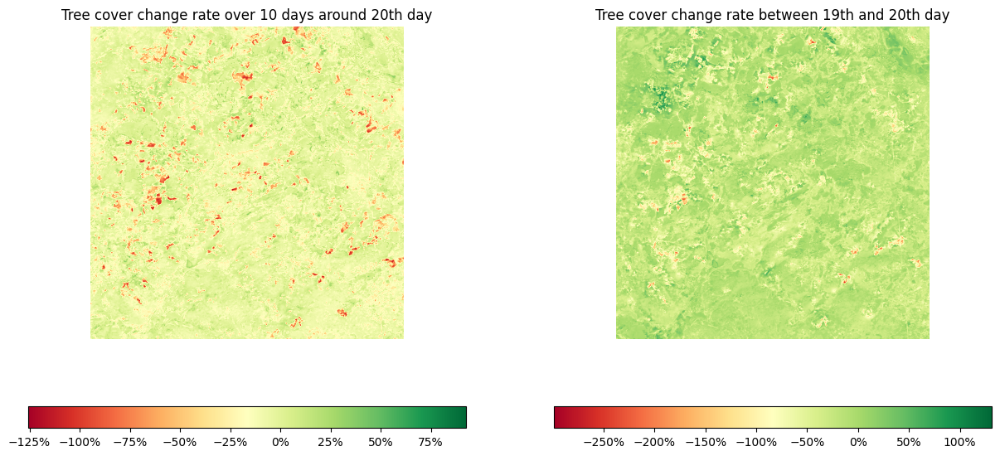

In [223]:
%matplotlib inline

fig, ax = plt.subplots(1, 2, figsize=(15, 7))
im0 = ax[0].imshow(slope_map * 365, cmap='RdYlGn')
ax[0].set_title(f'Tree cover change rate over {2*K} days around {n}th day')
ax[0].axis('off')
im1 = ax[1].imshow(change_rate * 365, cmap='RdYlGn')
ax[1].set_title(f'Tree cover change rate between {n-1}th and {n}th day')
ax[1].axis('off')
#AD COLORBARS
#add colorbar label : %/year
#firmat as percentage
import matplotlib.colors as mcolors
from matplotlib import ticker
formatter = ticker.PercentFormatter(xmax=1, decimals=0)
norm = mcolors.Normalize(vmin=-1, vmax=1)
fig.colorbar(mappable=im0, ax=ax[0], orientation='horizontal', format=formatter)
fig.colorbar(mappable=im1, ax=ax[1], orientation='horizontal', format=formatter)




/Users/arthurcalvi/Repo/ChangeDetectionDisturbances/.venv/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3577: UserWarning: Possible precision loss converting image of type float32 to uint8 as required by rank filters. Convert manually using skimage.util.img_as_ubyte to silence this warning.
  exec(code_obj, self.user_global_ns, self.user_ns)


Deciduous scaling factor: 4.07
Evergreen scaling factor: 5.75


  0%|          | 0/38 [00:00<?, ?it/s]

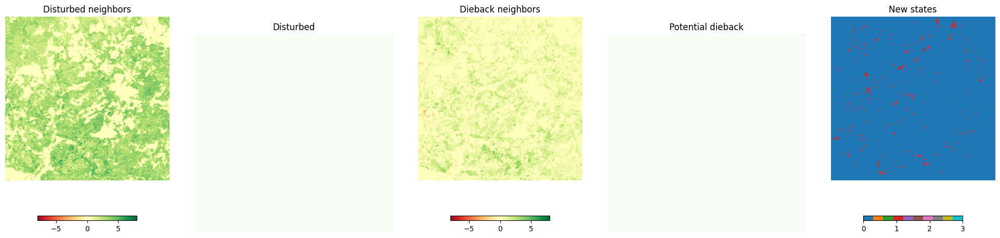

  3%|▎         | 1/38 [00:01<00:43,  1.17s/it]

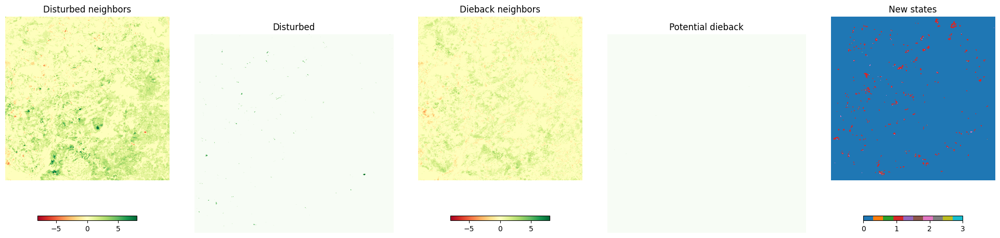

  5%|▌         | 2/38 [00:02<00:43,  1.20s/it]

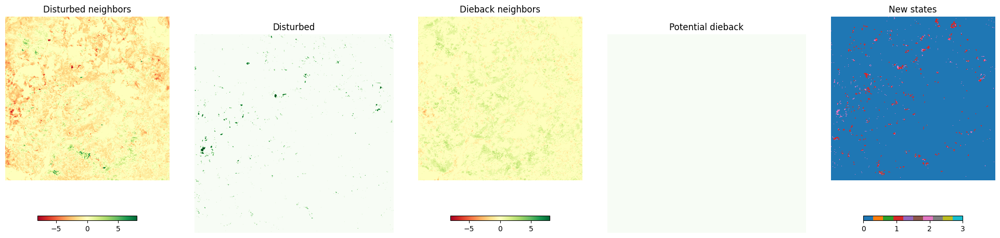

  8%|▊         | 3/38 [00:03<00:38,  1.11s/it]

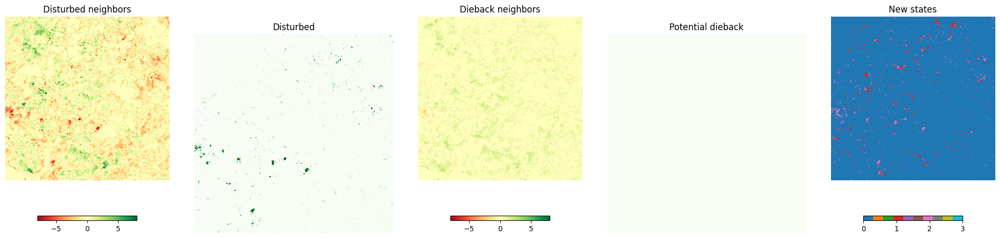

 11%|█         | 4/38 [00:04<00:37,  1.10s/it]

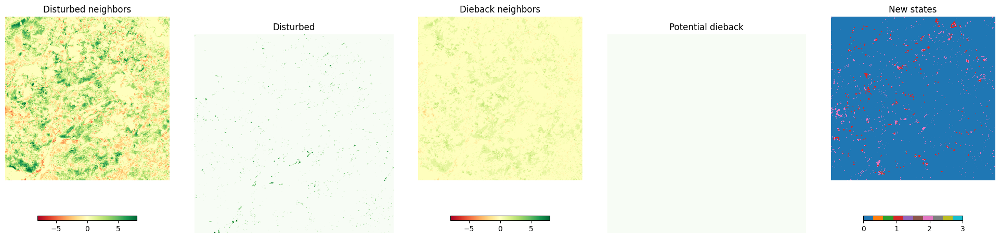

 13%|█▎        | 5/38 [00:05<00:38,  1.18s/it]

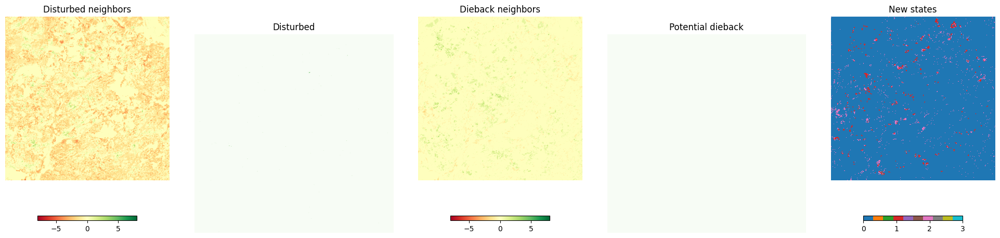

 16%|█▌        | 6/38 [00:06<00:35,  1.12s/it]

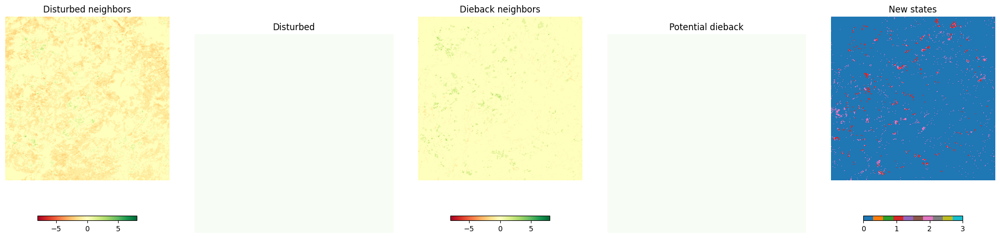

 18%|█▊        | 7/38 [00:07<00:33,  1.09s/it]

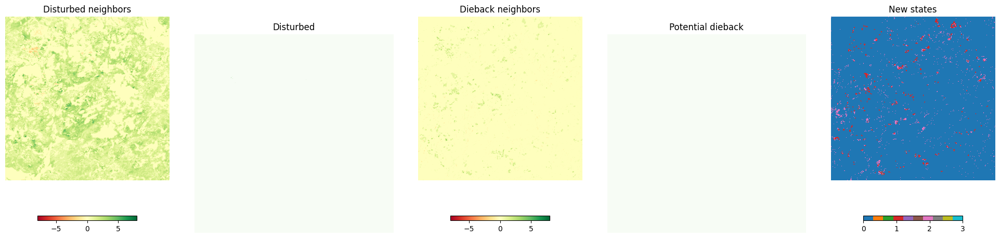

 21%|██        | 8/38 [00:09<00:36,  1.21s/it]

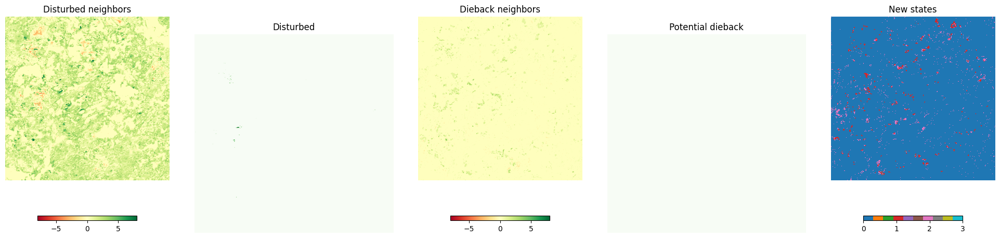

 24%|██▎       | 9/38 [00:10<00:38,  1.34s/it]

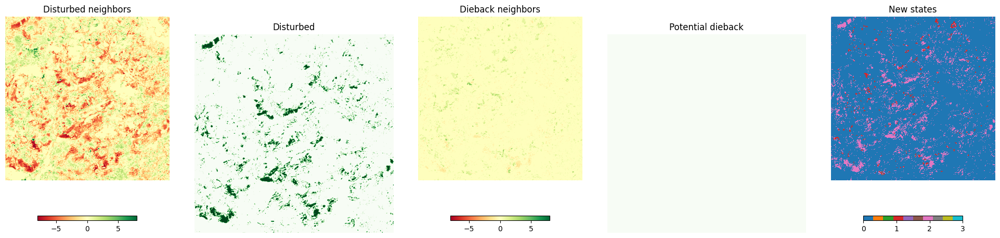

 26%|██▋       | 10/38 [00:12<00:37,  1.35s/it]

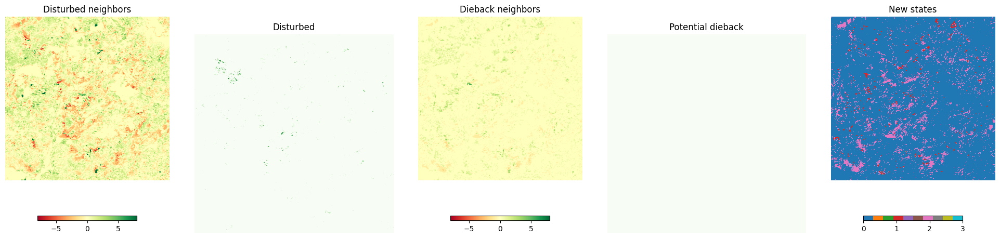

 29%|██▉       | 11/38 [00:13<00:34,  1.30s/it]

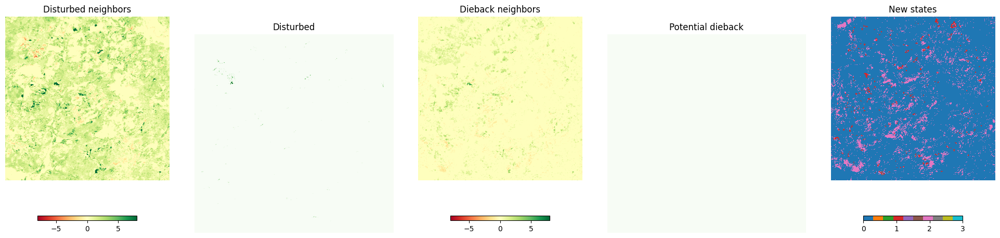

 32%|███▏      | 12/38 [00:14<00:31,  1.22s/it]

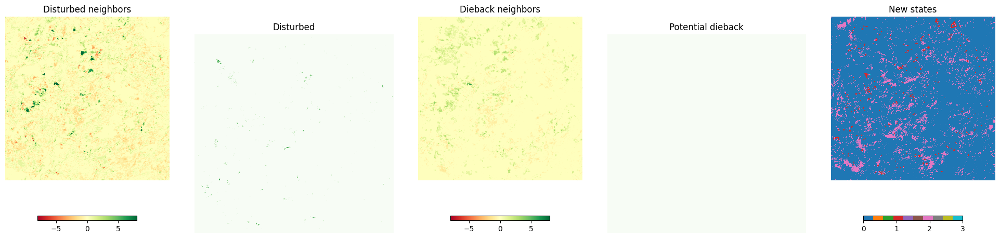

 34%|███▍      | 13/38 [00:15<00:31,  1.27s/it]

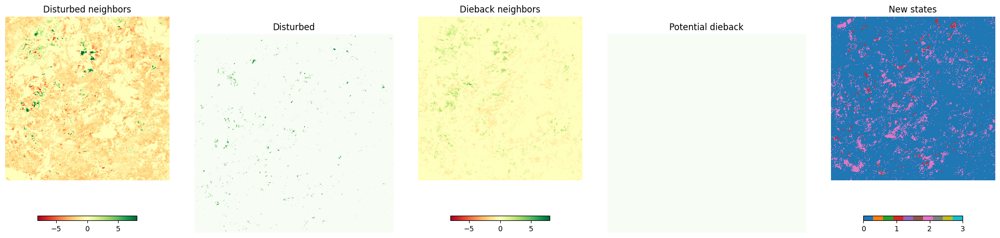

 37%|███▋      | 14/38 [00:17<00:29,  1.24s/it]

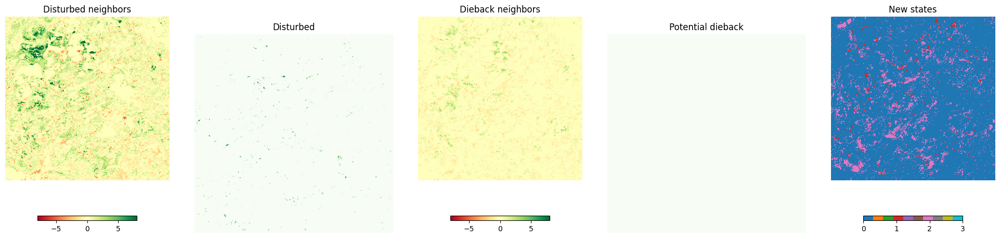

 39%|███▉      | 15/38 [00:18<00:27,  1.19s/it]

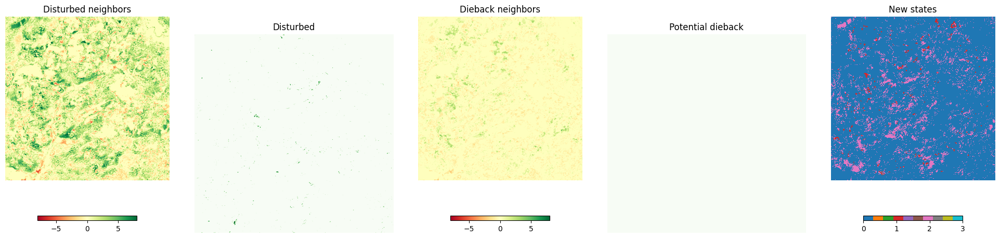

 42%|████▏     | 16/38 [00:19<00:27,  1.26s/it]

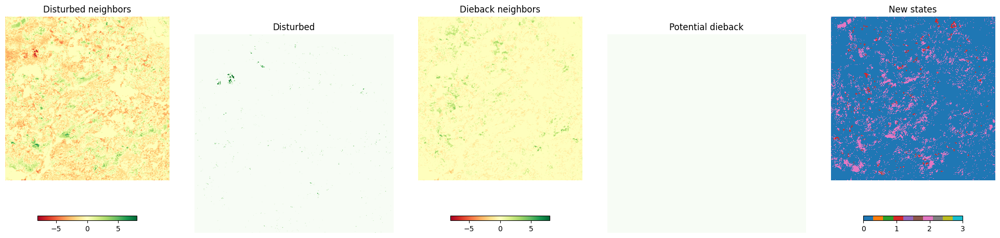

 45%|████▍     | 17/38 [00:20<00:27,  1.31s/it]

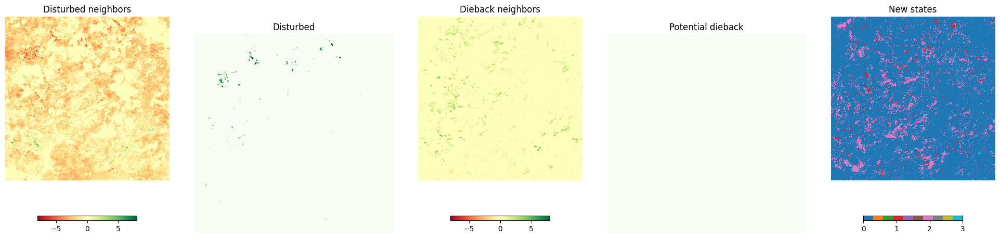

 47%|████▋     | 18/38 [00:22<00:25,  1.29s/it]

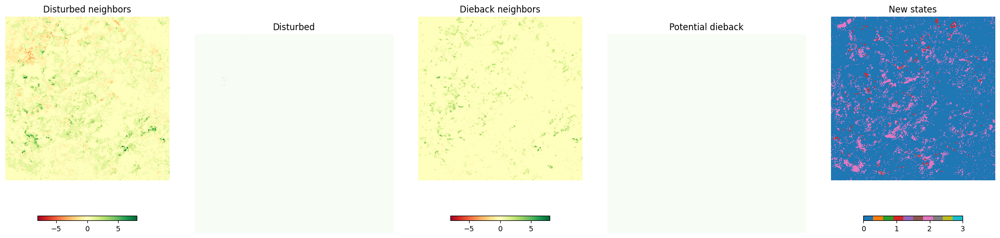

 50%|█████     | 19/38 [00:23<00:27,  1.42s/it]

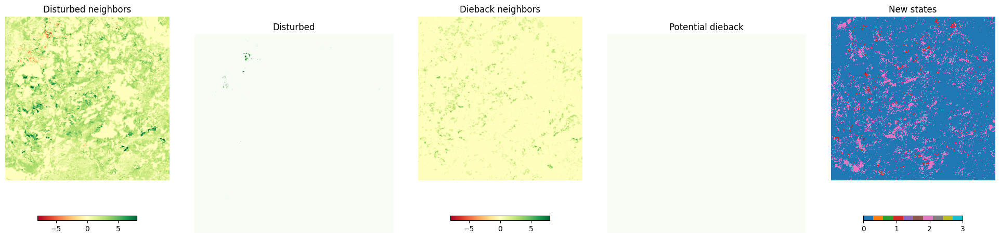

 53%|█████▎    | 20/38 [00:25<00:24,  1.35s/it]

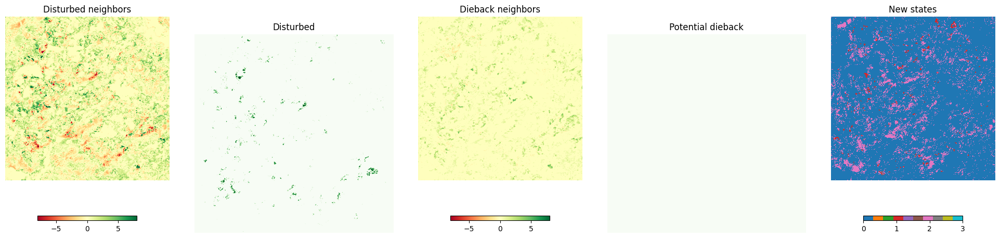

 55%|█████▌    | 21/38 [00:26<00:22,  1.31s/it]

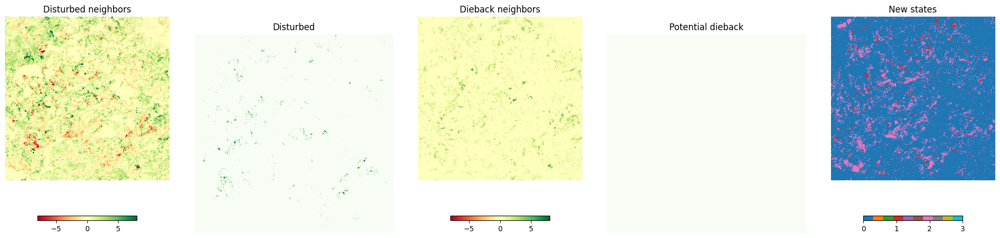

 58%|█████▊    | 22/38 [00:27<00:20,  1.26s/it]

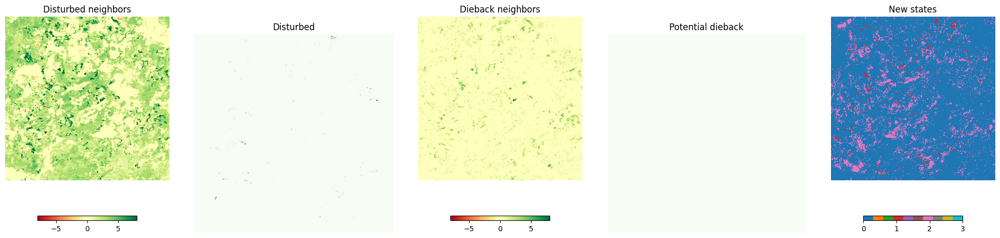

 61%|██████    | 23/38 [00:28<00:19,  1.30s/it]

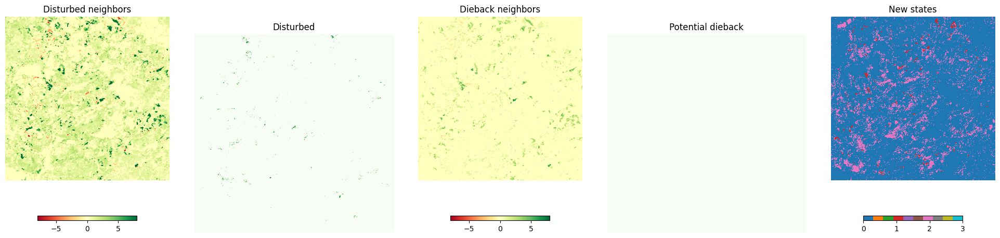

 63%|██████▎   | 24/38 [00:29<00:17,  1.24s/it]

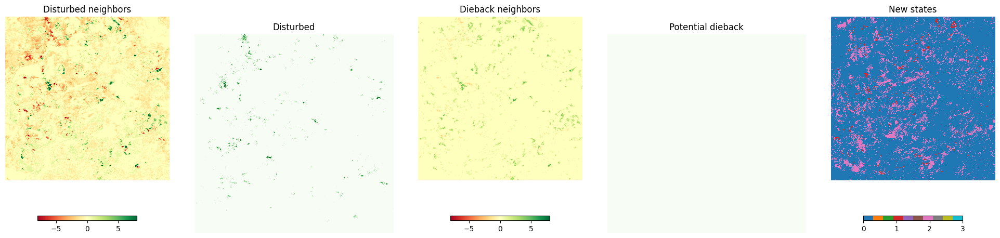

 66%|██████▌   | 25/38 [00:31<00:16,  1.28s/it]

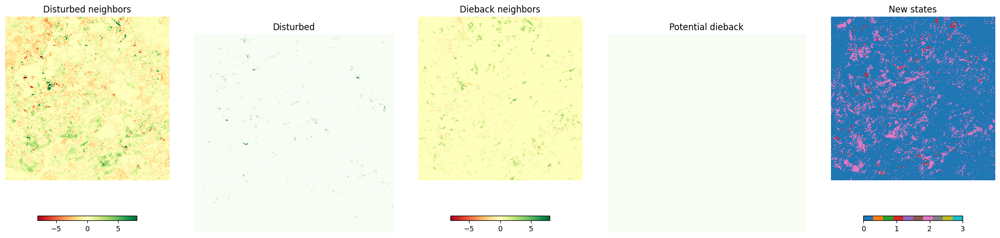

 68%|██████▊   | 26/38 [00:32<00:14,  1.23s/it]

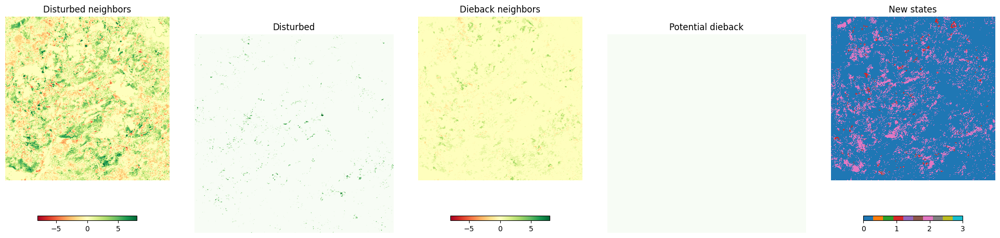

 71%|███████   | 27/38 [00:33<00:14,  1.29s/it]

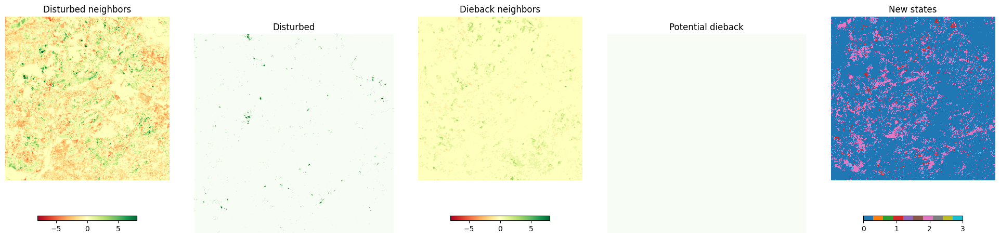

 74%|███████▎  | 28/38 [00:34<00:12,  1.23s/it]

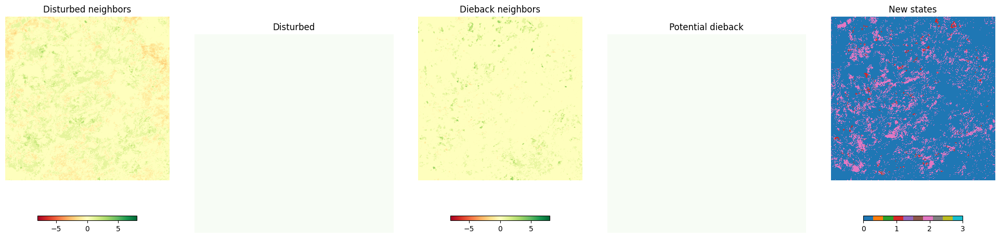

 76%|███████▋  | 29/38 [00:36<00:12,  1.41s/it]

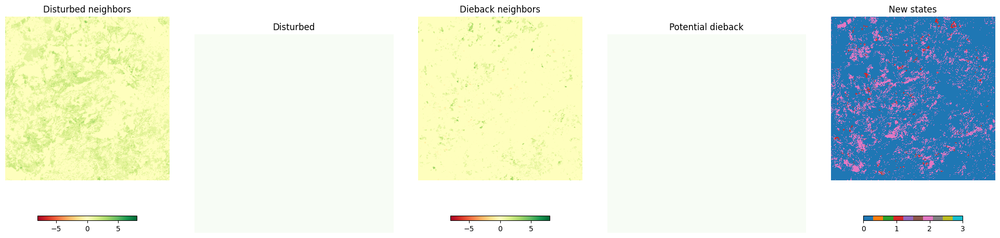

 79%|███████▉  | 30/38 [00:38<00:10,  1.36s/it]

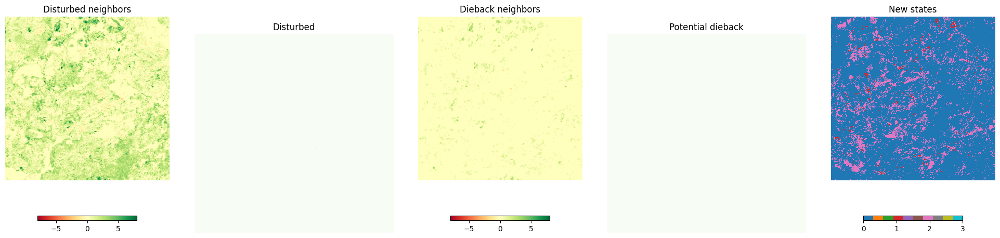

 82%|████████▏ | 31/38 [00:39<00:09,  1.35s/it]

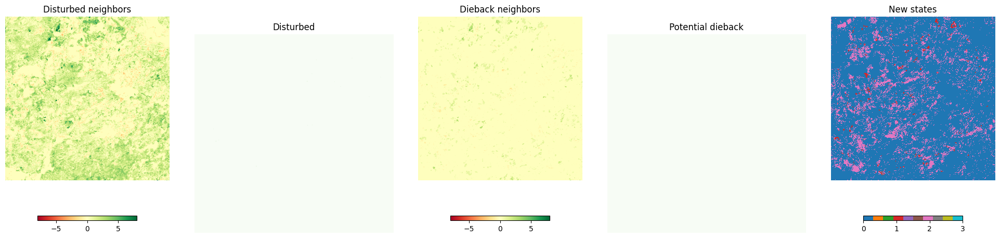

 84%|████████▍ | 32/38 [00:40<00:07,  1.32s/it]

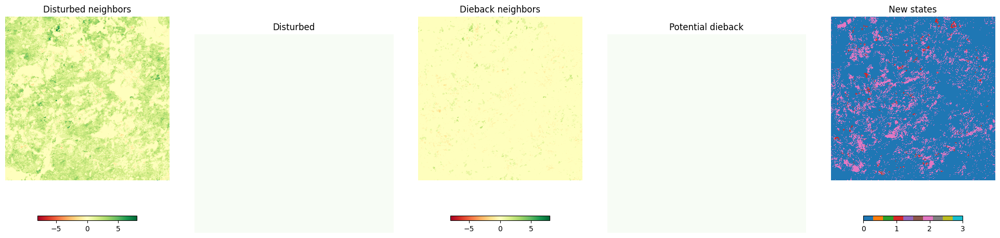

 87%|████████▋ | 33/38 [00:41<00:06,  1.27s/it]

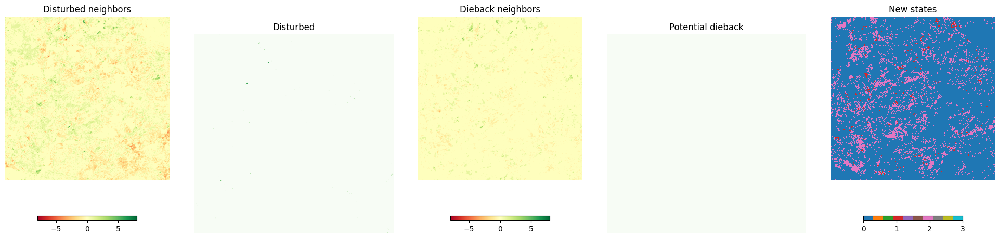

 89%|████████▉ | 34/38 [00:42<00:04,  1.20s/it]

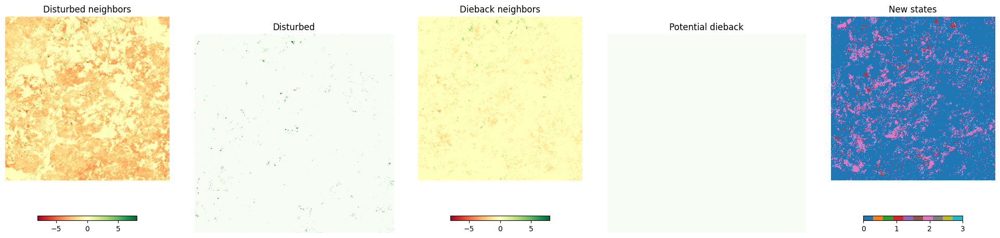

 92%|█████████▏| 35/38 [00:43<00:03,  1.15s/it]

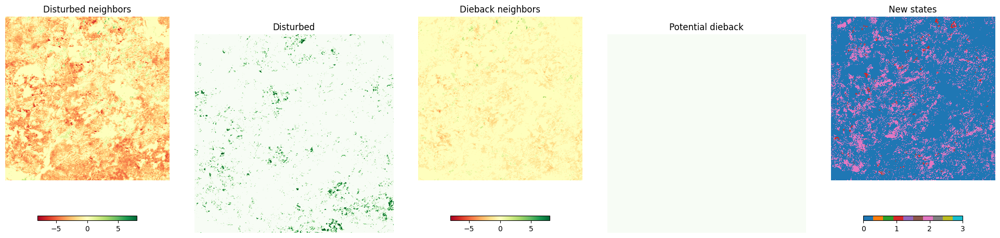

 95%|█████████▍| 36/38 [00:45<00:02,  1.20s/it]

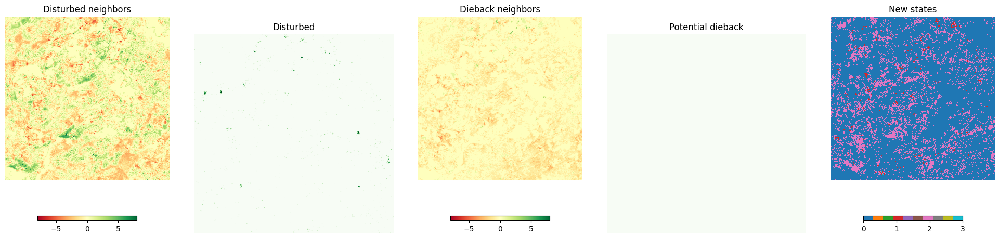

 97%|█████████▋| 37/38 [00:46<00:01,  1.24s/it]

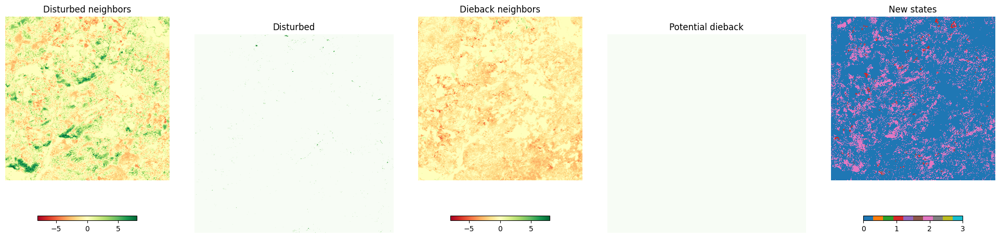

100%|██████████| 38/38 [00:47<00:00,  1.26s/it]


In [226]:
%matplotlib inline
import numpy as np
from scipy.ndimage import convolve

def update_state_with_cover_change(current_states, immediate_change, gradual_change, forest_prob_map, tree_type_map, scaling_factors=(20, 20), debug=False):
    """
    Update states using convolution to consider neighbor influence efficiently, including 
    tree cover change impact driven by immediate and gradual changes.

    Parameters:
    - current_states: 2D numpy array representing the current state of each pixel
    - immediate_change: 2D numpy array, percentage per day change between frame n-1 and n
    - gradual_change: 2D numpy array, percentage per day change between frame n-K and n+K
    - forest_prob_map: 2D numpy array, probability of forest presence
    - tree_type_map: 2D numpy array, 0 for deciduous, 1 for evergreen
    - scaling_factors: tuple, scaling factors for deciduous and evergreen trees

    Returns:
    - new_states: 2D numpy array representing the updated state of each pixel
    """
    # Define the convolution kernel
    kernel = np.array([[0.5, 1, 0.5],
                       [1, 2, 1],
                       [0.5, 1, 0.5]])

    # Apply convolution to count neighbors based on current state
    disturbed_neighbors = convolve(current_states == 2, kernel, mode='constant', cval=0).astype(int)
    dieback_neighbors = convolve(current_states == 1, kernel, mode='constant', cval=0).astype(int)

    # Calculate influence based on tree types and forest probability map
    immediate_influence = np.where(tree_type_map == 0,
                                   -immediate_change * scaling_factors[0],
                                   -immediate_change * scaling_factors[1])
    gradual_influence = np.where(tree_type_map == 0,
                                 -gradual_change * scaling_factors[0],
                                 -gradual_change * scaling_factors[1])
    
    immediate_influence *= forest_prob_map
    gradual_influence *= forest_prob_map

    immediate_influence = immediate_influence.astype(int)
    gradual_influence = gradual_influence.astype(int)

    disturbed_neighbors += immediate_influence
    dieback_neighbors += gradual_influence

    # Initialize new states array
    new_states = np.copy(current_states)

    # Update states based on rules
    # Potential dieback driven by gradual change
    is_undisturbed = (current_states == 0)
    new_states[(is_undisturbed) & (dieback_neighbors < -4)] = 1  # Potential dieback

    # Disturbed driven by immediate change
    is_potential_or_undisturbed = (current_states == 0) | (current_states == 1)
    new_states[(is_potential_or_undisturbed) & (disturbed_neighbors < -4)] = 2  # Disturbed

    # Recovery rule: more likely if there is significant positive change
    is_disturbed_or_dieback = (current_states == 1) | (current_states == 2)
    new_states[(is_disturbed_or_dieback) & (dieback_neighbors > 4)] = 3  # Recovery

    if debug:
        fig, ax = plt.subplots(1, 5, figsize=(20, 5))
        im0 = ax[0].imshow(disturbed_neighbors, cmap='RdYlGn', vmin=-8, vmax=8)
        ax[0].set_title('Disturbed neighbors')
        ax[0].axis('off')
        im1 = ax[1].imshow((is_potential_or_undisturbed) & (disturbed_neighbors < -4), cmap='Greens', vmin=0, vmax=1)
        ax[1].set_title('Disturbed')
        ax[1].axis('off')
        im2 = ax[2].imshow(dieback_neighbors, cmap='RdYlGn', vmin=-8, vmax=8)
        ax[2].set_title('Dieback neighbors')
        ax[2].axis('off')
        im3 = ax[3].imshow((is_undisturbed) & (dieback_neighbors < -4), cmap='Greens', vmin=0, vmax=1)
        ax[3].set_title('Potential dieback')
        ax[3].axis('off')
        im4 = ax[4].imshow(new_states, cmap='tab10', vmin=0, vmax=3, interpolation='none')
        ax[4].set_title('New states')
        ax[4].axis('off')

        fig.colorbar(im0, ax=ax[0], orientation='horizontal', shrink=0.5)
        fig.colorbar(im2, ax=ax[2], orientation='horizontal', shrink=0.5)
        fig.colorbar(im4, ax=ax[4], orientation='horizontal', shrink=0.5)
        plt.tight_layout()
        plt.show()


    return new_states



#TREE PROB
from skimage.filters import rank
from skimage.morphology import disk
tree_prob_folder = os.path.join(folder_path, 'tree_prob')
#read one file contained
with rasterio.open(os.path.join(tree_prob_folder, os.listdir(tree_prob_folder)[0])) as src:
    forest_segmentation = src.read(1)

nm = 5
mean_tree_prob = (rank.mean(forest_segmentation, disk(nm)) / 255).astype('float32')

# Compute stats for deciduous (assumed to be O) and evergreen (assumed to be 1)
disturbance_map = np.any(disturbances > 0, axis=0).astype(int)
deciduous_median, deciduous_std, deciduous_min, deciduous_max = compute_stats(tc_deseasonalized, tree_inf, 0, disturbance_map)
evergreen_median, evergreen_std, deciduous_min, deciduous_max = compute_stats(tc_deseasonalized, tree_inf, 1, disturbance_map)
scaling_factors = 2 * np.array((deciduous_median / deciduous_std, evergreen_median / evergreen_std))

print(f'Deciduous scaling factor: {scaling_factors[0]:.2f}')
print(f'Evergreen scaling factor: {scaling_factors[1]:.2f}')

initial_states = (disturbances[0] > 0).astype(int)
states = [initial_states]

from tqdm import tqdm
K = 5
for i in tqdm(range(1, len(tc))):
    # immediate_change = calculate_tree_cover_change(tc[i - 1], tc[i], dates[i - 1], dates[i]) * 365
    immediate_change = calculate_slope_with_dates(tc_deseasonalized, dates, i, 1) * 365
    gradual_change = calculate_slope_with_dates(tc_deseasonalized, dates, i, K) * 365
    initial_states = update_state_with_cover_change(current_states=initial_states, 
                                                    immediate_change=immediate_change, 
                                                    gradual_change=gradual_change, 
                                                    forest_prob_map=mean_tree_prob, 
                                                    tree_type_map=tree_inf, 
                                                    scaling_factors=scaling_factors,
                                                    debug=True)
    states.append(initial_states)


In [229]:
%matplotlib notebook
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


cmap = ListedColormap(['white', 'yellow', 'red', 'blue'])  # State colors

def animate_states(states, rgb):
    """
    Animate each state in the states list along with corresponding RGB images.

    Args:
    - states: List of numpy arrays, where each array represents the state grid at a time step.
    - rgb: List of RGB images corresponding to each state for visualization.
    """
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))

    # Initialize the plots
    state_img = ax[0].imshow(states[0], cmap=cmap, vmin=0, vmax=3, interpolation='none')
    rgb_img = ax[1].imshow(normalize(rgb[0]).transpose(1, 2, 0))
    
    ax[0].set_axis_off()
    ax[1].set_axis_off()
    ax[0].set_title('State Grid')
    ax[1].set_title('RGB Image')

    def update(frame):
        """Update function for animation."""
        state_img.set_data(states[frame])
        rgb_img.set_data(normalize(rgb[frame], gain=3).transpose(1, 2, 0))
        
        ax[0].set_title(f'Time Step: {frame}')
        return state_img, rgb_img,

    # Create animation
    ani = FuncAnimation(fig, update, frames=len(states), interval=100, blit=True)

    # plt.close(fig)  # Close the figure to prevent it from displaying statically
    return HTML(ani.to_jshtml()) 

# Example usage:
# Assuming 'states' and 'rgb' are lists of numpy arrays
# Example usage in your notebook
animation = animate_states(states, rgb)
display(animation)


<IPython.core.display.Javascript object>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

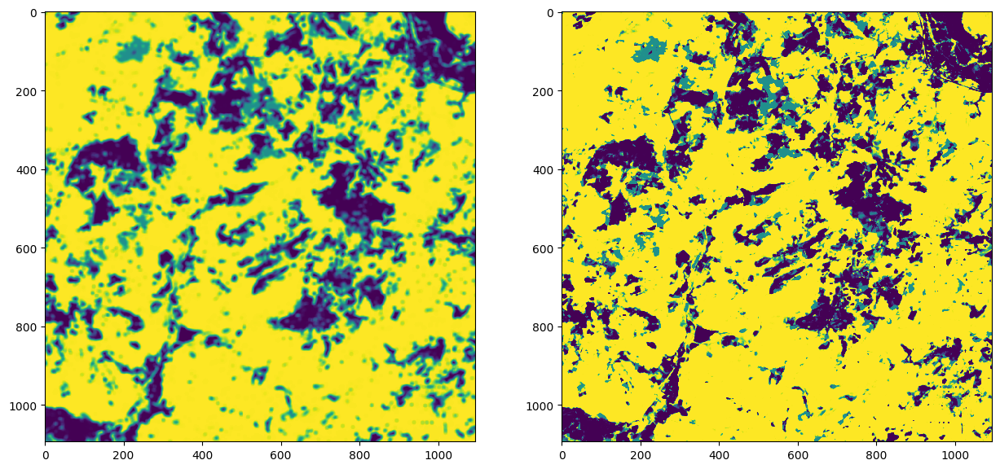

In [235]:
%matplotlib inline
fig, ax = plt.subplots(1, 2, figsize=(15, 7))
im1 = ax[0].imshow(mean_tree_prob, cmap='viridis', vmin=0, vmax=1, interpolation='none')
im2 = ax[1].imshow(forest_segmentation, cmap='viridis', vmin=0, vmax=1, interpolation='none')
